In [1]:
import os
import re

def find_files(directory):
    """Recursively find all numerically named files in the directory."""
    return [os.path.join(directory, f) for f in os.listdir(directory) if f.isdigit()]

def read_file(file_path):
    """Read the content of a file."""
    try:
        with open(file_path, 'r', encoding='utf-8') as file:
            return file.read()
    except UnicodeDecodeError:
        try:
            with open(file_path, 'r', encoding='ISO-8859-1') as file:
                return file.read()
        except UnicodeDecodeError:
            with open(file_path, 'r', errors='ignore') as file:
                return file.read()

def extract_emails(document):
    """Extract individual emails from the document."""
    return document.split("-----Original Message-----")

def clean_email_content(email):
    """Clean the content of an email by removing headers and other non-relevant parts."""
    cleaned = re.sub(r'(Message-ID|Date|Sent|Cc|From|To|Subject|Mime-Version|Content-Type|Content-Transfer-Encoding|X-[^\n]+):.*\n', '', email)
    cleaned = re.sub(r'\n+', '\n', cleaned)  # Remove excess newlines
    cleaned = re.sub(r'<< File:.*>>', '', cleaned)  # Remove file attachments line
    return cleaned.strip()

def create_question_answer_pairs(emails):
    """Create question-answer pairs from the cleaned emails."""
    q_a_pairs = []
    for i in range(len(emails) - 1, 0, -1):
        question = emails[i].strip()
        answer = emails[i-1].strip()
        if any(punct in question for punct in ['?', '.', '!']):
            q_a_pairs.append((question, answer))
    return q_a_pairs

def process_document(file_path):
    """Process a single document to extract question-answer pairs."""
    content = read_file(file_path)
    emails = extract_emails(content)
    cleaned_emails = [clean_email_content(email) for email in emails]
    return create_question_answer_pairs(cleaned_emails)

def process_customer_inbox(customer_inbox):
    """Process all documents in a customer's inbox to extract question-answer pairs."""
    files = find_files(customer_inbox)
    if not files:
        print(f"No numerically named files found in {customer_inbox}")
    all_q_a_pairs = []
    for file_path in files:
        print(f"Processing file: {file_path}")
        q_a_pairs = process_document(file_path)
        all_q_a_pairs.extend(q_a_pairs)
    return all_q_a_pairs

def process_all_customers(base_dir):
    """Process all customers' inboxes to extract question-answer pairs."""
    customers_data = {}
    for customer_folder in os.listdir(base_dir):
        customer_inbox = os.path.join(base_dir, customer_folder, 'inbox')
        if os.path.isdir(customer_inbox):
            print(f"Processing inbox for customer: {customer_folder}")
            all_q_a_pairs = process_customer_inbox(customer_inbox)
            customers_data[customer_folder] = all_q_a_pairs
        else:
            print(f"No inbox folder found for customer: {customer_folder}")
    return customers_data

# Define the base directory containing customer folders
base_dir = 'D:\mail_data'  # Change this to the path of your customers directory

# Process all customer data and get all question-answer pairs
all_customers_data = process_all_customers(base_dir)

# Print the question-answer pairs for each customer
for customer, q_a_pairs in all_customers_data.items():
    print(f"Customer: {customer}")
    for i, (question, answer) in enumerate(q_a_pairs, 1):
        print(f"Q{i}: {question}\nA{i}: {answer}\n")


Processing inbox for customer: allen-p
Processing file: D:\mail_data\allen-p\inbox\1
Processing file: D:\mail_data\allen-p\inbox\10
Processing file: D:\mail_data\allen-p\inbox\11
Processing file: D:\mail_data\allen-p\inbox\12
Processing file: D:\mail_data\allen-p\inbox\13
Processing file: D:\mail_data\allen-p\inbox\14
Processing file: D:\mail_data\allen-p\inbox\15
Processing file: D:\mail_data\allen-p\inbox\16
Processing file: D:\mail_data\allen-p\inbox\17
Processing file: D:\mail_data\allen-p\inbox\18
Processing file: D:\mail_data\allen-p\inbox\19
Processing file: D:\mail_data\allen-p\inbox\2
Processing file: D:\mail_data\allen-p\inbox\20
Processing file: D:\mail_data\allen-p\inbox\21
Processing file: D:\mail_data\allen-p\inbox\22
Processing file: D:\mail_data\allen-p\inbox\23
Processing file: D:\mail_data\allen-p\inbox\24
Processing file: D:\mail_data\allen-p\inbox\25
Processing file: D:\mail_data\allen-p\inbox\26
Processing file: D:\mail_data\allen-p\inbox\27
Processing file: D:\mai

In [2]:
import pandas as pd
import numpy as np

In [3]:
import json

In [4]:
q_a_list = [(question, answer) for q_a_pairs in all_customers_data.values() for question, answer in q_a_pairs]

# Create a DataFrame from the list
df = pd.DataFrame(q_a_list, columns=['Question', 'Answer'])

# Set the index to start from 1 instead of 0
df.index += 1

# Save the DataFrame to a CSV file
df.to_csv('q_a_data.csv', index_label='Index')

print("Data has been saved to q_a_data.csv")

# Optionally, print the DataFrame to verify
print(df)

Data has been saved to q_a_data.csv
                                               Question  \
1     Attached is the Delta position for 1/18, 1/31,...   
2     Heather,\nThis is exactly what we need.  Would...   
3      Heather,\nDid you attach the file to this email?   
4     > > > > > >\n> Greg/Phillip,\n>\n> Attached is...   
5     Richard,\nI spoke to you earlier this week wit...   
...                                                 ...   
3578  INA,\nTHIS IS WHAT WE HAVE FOR NOW.  MONDAY EV...   
3579  Today's Pre-Bid Meeting will be held in 05075 ...   
3580  On November 30, 2001, PG&E Gas Transmission, N...   
3581    http://www.satirewire.com/news/0111/enron.shtml   
3582  I have someone that works for me that's applie...   

                                                 Answer  
1     Heather,\nThis is exactly what we need.  Would...  
2     Attached is the Delta position for 1/16, 1/30,...  
3     Please let me know if you still need Curve Shi...  
4     Bcc: k..allen@enr

In [5]:
df.head()

,Question,Answer
1,"Attached is the Delta position for 1/18, 1/31,...","Heather,\nThis is exactly what we need. Would..."
2,"Heather,\nThis is exactly what we need. Would...","Attached is the Delta position for 1/16, 1/30,..."
3,"Heather,\nDid you attach the file to this email?",Please let me know if you still need Curve Shi...
4,"> > > > > >\n> Greg/Phillip,\n>\n> Attached is...","Bcc: k..allen@enron.com\nGreg/Phillip,\nI will..."
5,"Richard,\nI spoke to you earlier this week wit...","Phillip, there are a number of alternative sys..."


In [6]:
df.describe()

,Question,Answer
count,3582,3582
unique,2980,2884
top,"Tom,\nPlease inform me of the CMS Field Servic...",
freq,7,261


In [7]:
df['Answer'].isnull().sum()



0

In [8]:
len(df)

3582

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
from collections import Counter

In [10]:


# Load the dataset
df = pd.read_csv('q_a_data.csv', index_col='Index')

# Display the first few rows of the DataFrame
print("First few rows of the DataFrame:")
print(df.head())

# Basic information and summary statistics
print("\nBasic Information:")
print(df.info())

print("\nSummary Statistics:")
print(df.describe())

# Missing values analysis
print("\nMissing Values Count:")
print(df.isnull().sum())


# Handle missing values by filling them with an empty string
df['Question'].fillna('', inplace=True)
df['Answer'].fillna('', inplace=True)




First few rows of the DataFrame:
                                                Question  \
Index                                                      
1      Attached is the Delta position for 1/18, 1/31,...   
2      Heather,\nThis is exactly what we need.  Would...   
3       Heather,\nDid you attach the file to this email?   
4      > > > > > >\n> Greg/Phillip,\n>\n> Attached is...   
5      Richard,\nI spoke to you earlier this week wit...   

                                                  Answer  
Index                                                     
1      Heather,\nThis is exactly what we need.  Would...  
2      Attached is the Delta position for 1/16, 1/30,...  
3      Please let me know if you still need Curve Shi...  
4      Bcc: k..allen@enron.com\nGreg/Phillip,\nI will...  
5      Phillip, there are a number of alternative sys...  

Basic Information:
<class 'pandas.core.frame.DataFrame'>
Index: 3582 entries, 1 to 3582
Data columns (total 2 columns):
 #   Column 

C:\Users\hp\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


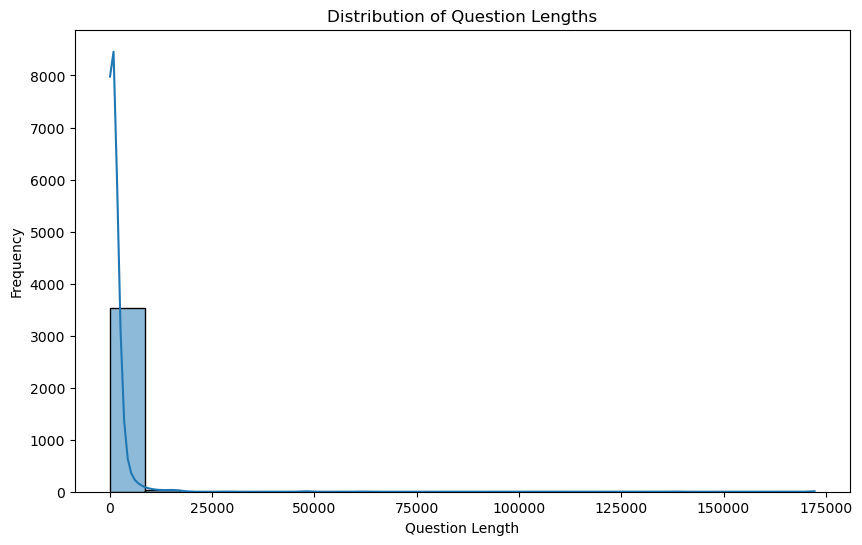

In [11]:
# Distribution of question lengths
df['Question_Length'] = df['Question'].apply(len)
plt.figure(figsize=(10, 6))
sns.histplot(df['Question_Length'], bins=20, kde=True)
plt.title('Distribution of Question Lengths')
plt.xlabel('Question Length')
plt.ylabel('Frequency')
plt.show()

C:\Users\hp\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


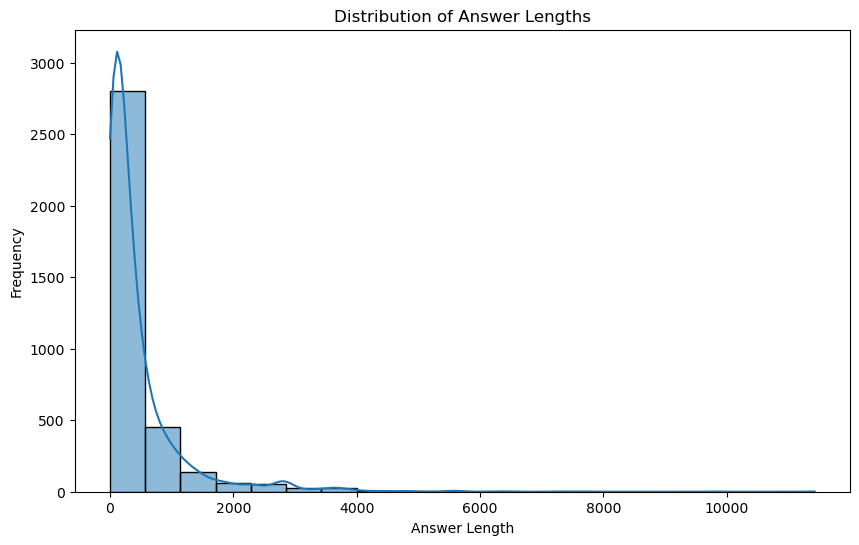

In [12]:
# Distribution of answer lengths
df['Answer_Length'] = df['Answer'].apply(len)
plt.figure(figsize=(10, 6))
sns.histplot(df['Answer_Length'], bins=20, kde=True)
plt.title('Distribution of Answer Lengths')
plt.xlabel('Answer Length')
plt.ylabel('Frequency')
plt.show()


In [13]:
# Common words in questions and answers
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

def get_most_common_words(text_series, num_words=10):
    all_words = ' '.join(text_series).lower().split()
    filtered_words = [word for word in all_words if word not in stop_words and word.isalpha()]
    word_counts = Counter(filtered_words)
    return word_counts.most_common(num_words)

common_words_questions = get_most_common_words(df['Question'])
common_words_answers = get_most_common_words(df['Answer'])

print("\nMost Common Words in Questions:")
print(common_words_questions)

print("\nMost Common Words in Answers:")
print(common_words_answers)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\hp\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!



Most Common Words in Questions:
[('active', 3009), ('position', 2020), ('please', 1870), ('would', 1867), ('enron', 1720), ('power', 1346), ('may', 1212), ('intended', 959), ('need', 936), ('know', 930)]

Most Common Words in Answers:
[('would', 889), ('please', 667), ('know', 567), ('get', 548), ('need', 523), ('let', 453), ('like', 384), ('enron', 369), ('think', 347), ('thanks', 319)]


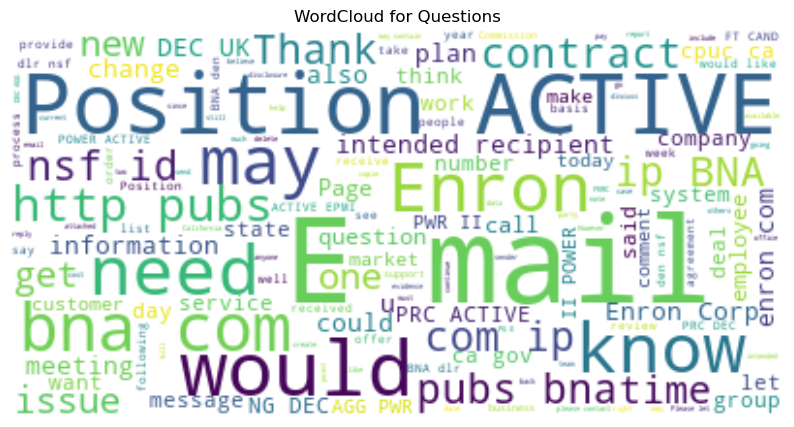

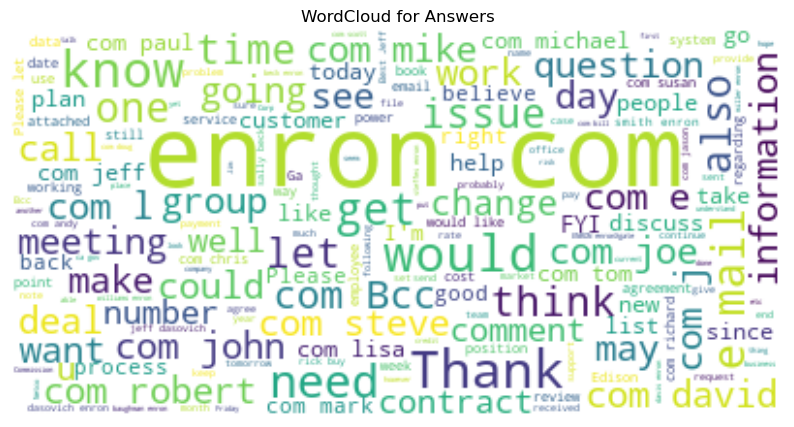

In [14]:

# WordCloud for questions and answers
def plot_wordcloud(text_series, title):
    text = ' '.join(text_series)
    wordcloud = WordCloud(stopwords=stop_words, background_color='white').generate(text)
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title)
    plt.axis('off')
    plt.show()

plot_wordcloud(df['Question'], 'WordCloud for Questions')
plot_wordcloud(df['Answer'], 'WordCloud for Answers')


In [15]:
# Number of unique questions and answers
num_unique_questions = df['Question'].nunique()
num_unique_answers = df['Answer'].nunique()

print(f"Number of unique questions: {num_unique_questions}")
print(f"Number of unique answers: {num_unique_answers}")


Number of unique questions: 2980
Number of unique answers: 2884


In [16]:
# Summary statistics for question and answer lengths
print("\nSummary Statistics for Question Lengths:")
print(df['Question'].describe())

print("\nSummary Statistics for Answer Lengths:")
print(df['Answer'].describe())



Summary Statistics for Question Lengths:
count                                                  3582
unique                                                 2980
top       Tom,\nPlease inform me of the CMS Field Servic...
freq                                                      7
Name: Question, dtype: object

Summary Statistics for Answer Lengths:
count     3582
unique    2884
top           
freq       261
Name: Answer, dtype: object


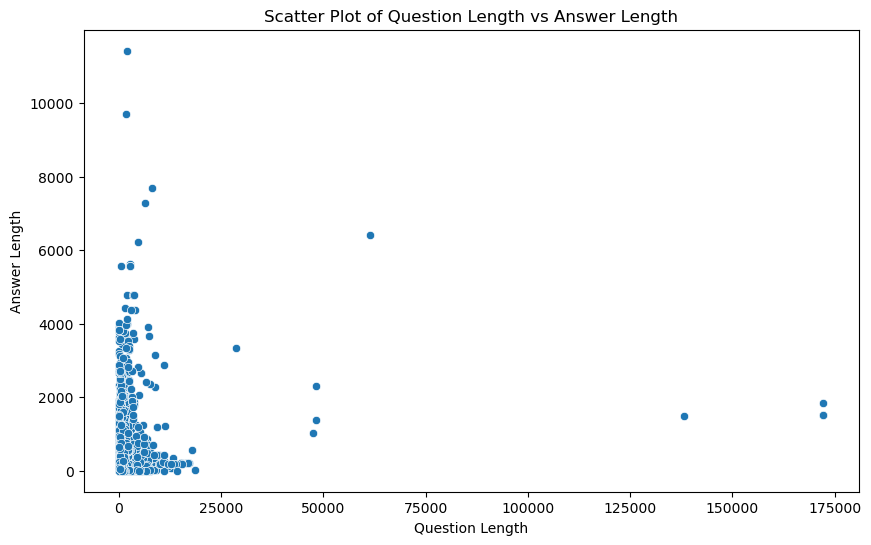

In [17]:
# Scatter plot to examine correlation between question length and answer length
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Question_Length', y='Answer_Length', data=df)
plt.title('Scatter Plot of Question Length vs Answer Length')
plt.xlabel('Question Length')
plt.ylabel('Answer Length')
plt.show()



Available columns in DataFrame:
Index(['Question', 'Answer', 'Question_Length', 'Answer_Length'], dtype='object')


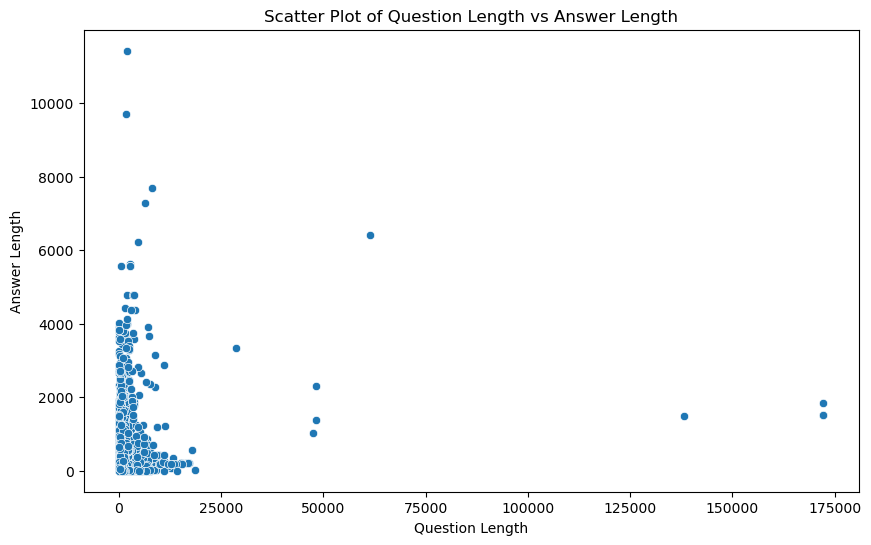

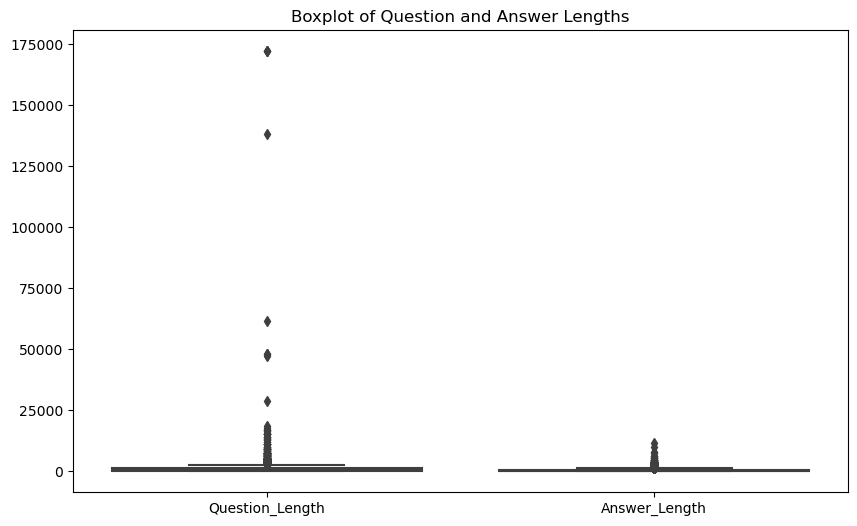

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
from collections import Counter

# Load the dataset
df = pd.read_csv('q_a_data.csv', index_col='Index')

# Fill missing values
df['Question'].fillna('', inplace=True)
df['Answer'].fillna('', inplace=True)

# Add lengths for further analysis
df['Question_Length'] = df['Question'].apply(len)
df['Answer_Length'] = df['Answer'].apply(len)

# Check for available columns
print("\nAvailable columns in DataFrame:")
print(df.columns)

# Ensure that 'Question_Length' and 'Answer_Length' are in the DataFrame
if 'Question_Length' in df.columns and 'Answer_Length' in df.columns:
    # Scatter plot to examine correlation
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='Question_Length', y='Answer_Length', data=df)
    plt.title('Scatter Plot of Question Length vs Answer Length')
    plt.xlabel('Question Length')
    plt.ylabel('Answer Length')
    plt.show()

    # Boxplot of lengths
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df[['Question_Length', 'Answer_Length']])
    plt.title('Boxplot of Question and Answer Lengths')
    plt.show()
else:
    print("Columns 'Question_Length' or 'Answer_Length' are missing in the DataFrame.")


In [19]:
# Check for duplicate questions and answers
duplicate_questions = df[df.duplicated('Question', keep='first')]
duplicate_answers = df[df.duplicated('Answer', keep='first')]

print("\nDuplicate Questions:")
print(duplicate_questions)

print("\nDuplicate Answers:")
print(duplicate_answers)

# Drop duplicates
df = df.drop_duplicates(subset=['Question', 'Answer'])



Duplicate Questions:
                                                Question  \
Index                                                      
22     John, \nI'm going into Financial trading/posit...   
23     The problem probably relates to the Exotica ad...   
24     Thanks. \nCurrently it is for my own purpose. ...   
25     Frank:\nCan you explain in detail the reasons ...   
41     Savita,\nThis report has been reviewed.  It is...   
...                                                  ...   
3548   To remain consistent with Enron's directive to...   
3552   This is a summary of the comments we've receiv...   
3559   <http://images.clickability.com/eti/spacer.gif...   
3566   Hello everyone:  \nWould you please forward th...   
3567   Please forward to your groups...\nThe Gas Fund...   

                                                  Answer  Question_Length  \
Index                                                                       
22     The problem probably relates to the 

In [20]:
# Function to clean text data
def clean_text(text):
    text = text.lower().strip()
    return text

df['Question'] = df['Question'].apply(clean_text)
df['Answer'] = df['Answer'].apply(clean_text)


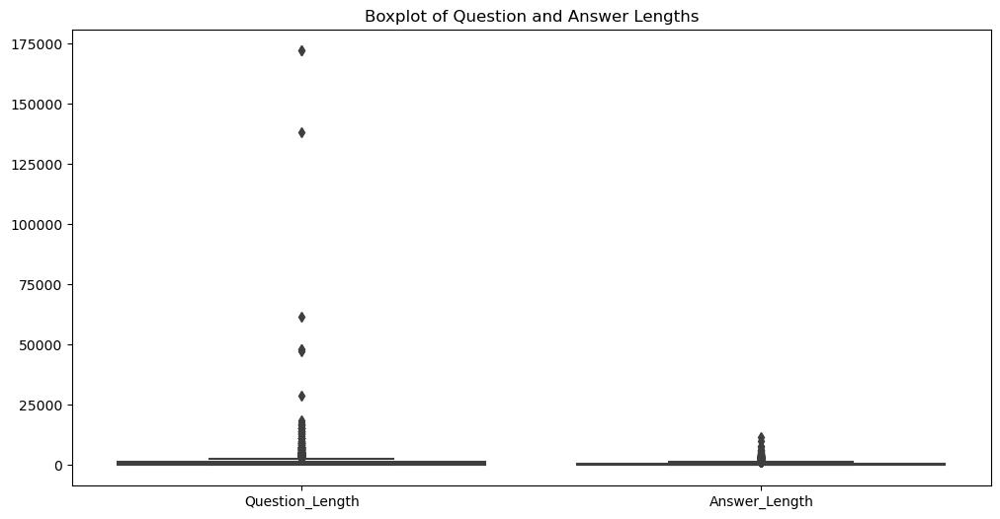

In [21]:
# Calculate lengths
df['Question_Length'] = df['Question'].apply(len)
df['Answer_Length'] = df['Answer'].apply(len)

# Plot length distributions to identify outliers
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.boxplot(data=df[['Question_Length', 'Answer_Length']])
plt.title('Boxplot of Question and Answer Lengths')
plt.show()

# Remove outliers if necessary (e.g., lengths that are unusually high or low)
q1_question = df['Question_Length'].quantile(0.25)
q3_question = df['Question_Length'].quantile(0.75)
iqr_question = q3_question - q1_question

q1_answer = df['Answer_Length'].quantile(0.25)
q3_answer = df['Answer_Length'].quantile(0.75)
iqr_answer = q3_answer - q1_answer

# Define outlier bounds
lower_bound_question = q1_question - 1.5 * iqr_question
upper_bound_question = q3_question + 1.5 * iqr_question

lower_bound_answer = q1_answer - 1.5 * iqr_answer
upper_bound_answer = q3_answer + 1.5 * iqr_answer

# Filter out outliers
df = df[(df['Question_Length'] >= lower_bound_question) & (df['Question_Length'] <= upper_bound_question)]
df = df[(df['Answer_Length'] >= lower_bound_answer) & (df['Answer_Length'] <= upper_bound_answer)]


In [22]:
# Check data types
print("\nData Types:")
print(df.dtypes)

# Ensure that text columns are of object type
df['Question'] = df['Question'].astype(str)
df['Answer'] = df['Answer'].astype(str)

# Verify data consistency
print("\nSample Data After Cleaning:")
print(df.head())



Data Types:
Question           object
Answer             object
Question_Length     int64
Answer_Length       int64
dtype: object

Sample Data After Cleaning:
                                                Question  \
Index                                                      
1      attached is the delta position for 1/18, 1/31,...   
2      heather,\nthis is exactly what we need.  would...   
3       heather,\ndid you attach the file to this email?   
4      > > > > > >\n> greg/phillip,\n>\n> attached is...   
5      richard,\ni spoke to you earlier this week wit...   

                                                  Answer  Question_Length  \
Index                                                                       
1      heather,\nthis is exactly what we need.  would...              113   
2      attached is the delta position for 1/16, 1/30,...              254   
3      please let me know if you still need curve shi...               47   
4      bcc: k..allen@enron.com\ngr

In [23]:
df.shape

(2735, 4)

In [24]:
#!pip install transformers torch


In [25]:
#!pip install transformers==4.25.1


In [26]:
#!pip install torch --user


In [27]:
#!pip install torch torchvision torchaudio


In [28]:
!pip install transformers
#!pip install datasets
#!pip install transformers
#!pip install openai
#!pip install sentencepiece
#!pip install --upgrade transformers sentencepiece
!pip install tf-keras




In [29]:
!pip install datasets sentencepiece


In [30]:
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import torch
from sklearn.model_selection import train_test_split
import pandas as pd
from datasets import Dataset

In [31]:
df['Question'].fillna('', inplace=True)  # Replace missing questions with an empty string
df['Answer'].fillna('', inplace=True)    # Replace missing intents with an empty string


In [32]:


df['Question'].fillna('', inplace=True)  # Replace missing questions with an empty string
df['Answer'].fillna('', inplace=True)    # Replace missing intents with an empty string


# Load the dataset
df = pd.read_csv('q_a_data.csv', index_col='Index')
df.columns = df.columns.str.strip()  # Strip any leading/trailing spaces

df['Question'].fillna('', inplace=True)  # Replace missing questions with an empty string
df['Answer'].fillna('', inplace=True)    # Replace missing intents with an empty string

df.dropna(subset=['Question', 'Answer'], inplace=True)




# Convert to Dataset format again with encoded labels
dataset = Dataset.from_pandas(df[['Question', 'Answer']])










In [33]:
from transformers import T5Tokenizer

# Load the tokenizer
tokenizer = T5Tokenizer.from_pretrained('t5-small')

# Remove index if it exists
if 'index' in dataset.column_names:
    dataset = dataset.remove_columns(['index'])

def tokenize_function(examples):
    print("Examples:", examples)  # Print examples to check input format
    
    model_inputs = tokenizer(examples['Question'], max_length=512, truncation=True, padding='max_length')
    print("Model Inputs:", model_inputs)  # Print model inputs to check output
    
    with tokenizer.as_target_tokenizer():
        labels = tokenizer(examples['Answer'], max_length=512, truncation=True, padding='max_length')
        print("Labels:", labels)  # Print labels to check output

    model_inputs["labels"] = labels["input_ids"]
    return model_inputs


You are using the default legacy behaviour of the <class 'transformers.models.t5.tokenization_t5.T5Tokenizer'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [34]:
print(df['Answer'].isnull().sum())


0


In [35]:
# Tokenize again
tokenized_datasets = dataset.map(tokenize_function, batched=True)

# Optionally, re-add index if needed
tokenized_datasets = tokenized_datasets.add_column('index', list(range(len(tokenized_datasets))))

print(tokenized_datasets)

# Split the dataset
train_test_split = tokenized_datasets.train_test_split(test_size=0.2)
train_dataset = train_test_split['train']
eval_dataset = train_test_split['test']

# Remove unused columns
train_dataset = train_dataset.remove_columns(['Question', 'Answer'])
eval_dataset = eval_dataset.remove_columns(['Question', 'Answer'])

# Set format for PyTorch
train_dataset.set_format(type='torch', columns=['input_ids', 'attention_mask', 'labels'])
eval_dataset.set_format(type='torch', columns=['input_ids', 'attention_mask', 'labels'])

Map:   0%|          | 0/3582 [00:00<?, ? examples/s]

Examples: {'Question': ['Attached is the Delta position for 1/18, 1/31, 6/20, 7/16, 9/24\n  \nLet me know if you have any questions.\nHeather', 'Heather,\nThis is exactly what we need.  Would it possible to add the prior day for each of the dates below to the pivot table.  In order to validate the curve shift on the dates below we also need the prior days ending positions.\nThank you,\nPhillip Allen', 'Heather,\nDid you attach the file to this email?', '> > > > > >\n> Greg/Phillip,\n>\n> Attached is the Grande Communications Service Agreement.  The business\n> points can be found in Exhibit C.  I Can get the Non-Disturbance agreement\n> after it has been executed by you and Grande.  I will fill in the Legal\n> description of the property one I have received it.  Please execute and\n> send to:  Grande Communications, 401 Carlson Circle, San Marcos Texas,\n> 78666 Attention Hunter Williams.\n>\n>\n>\n> Hunter Williams\n> Grande Communications\n> Wireless 512-757-2794\n> 512-878-5467\n>',

C:\Users\hp\anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:4016: UserWarning: `as_target_tokenizer` is deprecated and will be removed in v5 of Transformers. You can tokenize your labels by using the argument `text_target` of the regular `__call__` method (either in the same call as your input texts if you use the same keyword arguments, or in a separate call.
  warnings.warn(


Labels: {'input_ids': [[21238, 6, 100, 19, 1776, 125, 62, 174, 5, 5328, 34, 487, 12, 617, 8, 1884, 239, 21, 284, 13, 8, 5128, 666, 12, 8, 16959, 953, 5, 86, 455, 12, 16742, 8, 8435, 4108, 30, 8, 5128, 666, 62, 92, 174, 8, 1884, 477, 7784, 4655, 5, 1562, 25, 6, 16202, 10618, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [36]:
!pip install accelerate -U
!pip install transformers[torch]
!pip install torch torchvision torchaudio


In [37]:


from transformers import T5ForConditionalGeneration, Trainer, TrainingArguments

# Load the model
model = T5ForConditionalGeneration.from_pretrained('t5-small')

# Define training arguments
training_args = TrainingArguments(
    output_dir='D:\out',
    num_train_epochs=1,
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    warmup_steps=50,
    weight_decay=0.01,
    logging_dir='D:\out',
)

In [38]:
# Create the Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
)

# Train the model
trainer.train()


Step,Training Loss


TrainOutput(global_step=359, training_loss=3.0828578598319987, metrics={'train_runtime': 58230.9893, 'train_samples_per_second': 0.049, 'train_steps_per_second': 0.006, 'total_flos': 387754261217280.0, 'train_loss': 3.0828578598319987, 'epoch': 1.0})

In [39]:
torch.__version__

'2.3.1+cpu'

In [41]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

# Evaluate model on validation/test set
eval_results = trainer.evaluate()

print("Evaluation results:", eval_results)




Evaluation results: {'eval_loss': 0.8668439388275146, 'eval_runtime': 4623.9934, 'eval_samples_per_second': 0.155, 'eval_steps_per_second': 0.019, 'epoch': 1.0}


NameError: name 'test_dataset' is not defined

In [62]:
import random
from datasets import Dataset

# Assume `val_dataset` is your full validation dataset in the Hugging Face Dataset format
# Here we sample 5 examples from the validation dataset
sample_size = 5
random_indices = random.sample(range(len(eval_dataset)), sample_size)
sampled_val_dataset = eval_dataset.select(random_indices)


In [63]:
# Inspect the format of predictions and labels
print("Type of predictions:", type(predictions))
print("Type of labels:", type(labels))
print("Shape of predictions:", predictions.shape if hasattr(predictions, 'shape') else 'No shape attribute')
print("Shape of labels:", labels.shape if hasattr(labels, 'shape') else 'No shape attribute')

# Print a few examples from predictions and labels
print("Sample predictions:", predictions[:2])
print("Sample labels:", labels[:2])


Type of predictions: <class 'tuple'>
Type of labels: <class 'numpy.ndarray'>
Shape of predictions: No shape attribute
Shape of labels: (1, 512)
Sample predictions: (array([[[ 21.416006 ,  -4.168866 ,  -4.506829 , ..., -29.822275 ,
         -29.876022 , -29.85244  ],
        [ -0.9636736,  -6.1373568,  -4.5330915, ..., -31.622585 ,
         -31.766928 , -31.713326 ],
        [ -2.4211574,  -6.4270306,  -5.3230195, ..., -33.961414 ,
         -34.029987 , -33.983135 ],
        ...,
        [ 30.126421 ,  -4.2253504,  -1.4844208, ..., -26.157032 ,
         -26.18568  , -26.152725 ],
        [ 30.121975 ,  -4.2244906,  -1.4854285, ..., -26.157677 ,
         -26.186348 , -26.153397 ],
        [ 30.117588 ,  -4.2236247,  -1.4864297, ..., -26.15829  ,
         -26.187    , -26.154049 ]]], dtype=float32), array([[[-0.27146256,  0.05913019,  0.05172585, ..., -0.01810542,
         -0.25997666, -0.11094768],
        [ 0.00181359, -0.11511964, -0.08832662, ...,  0.18809898,
         -0.0967935 , -0

In [64]:
# Extract predictions from the tuple
preds_logits = predictions[0]  # Typically, the logits are in the first element
preds_logits

array([[[ 21.416006 ,  -4.168866 ,  -4.506829 , ..., -29.822275 ,
         -29.876022 , -29.85244  ],
        [ -0.9636736,  -6.1373568,  -4.5330915, ..., -31.622585 ,
         -31.766928 , -31.713326 ],
        [ -2.4211574,  -6.4270306,  -5.3230195, ..., -33.961414 ,
         -34.029987 , -33.983135 ],
        ...,
        [ 30.126421 ,  -4.2253504,  -1.4844208, ..., -26.157032 ,
         -26.18568  , -26.152725 ],
        [ 30.121975 ,  -4.2244906,  -1.4854285, ..., -26.157677 ,
         -26.186348 , -26.153397 ],
        [ 30.117588 ,  -4.2236247,  -1.4864297, ..., -26.15829  ,
         -26.187    , -26.154049 ]]], dtype=float32)

In [65]:
import numpy as np

# Ensure logits are in numpy format
if isinstance(preds_logits, torch.Tensor):
    preds_logits = preds_logits.cpu().numpy()

# Convert logits to predicted token IDs
predicted_ids = np.argmax(preds_logits, axis=-1)


In [66]:
from transformers import T5Tokenizer

# Initialize the tokenizer
tokenizer = T5Tokenizer.from_pretrained("t5-small")

# Decode predictions and labels
decoded_preds = [tokenizer.decode(pred_id, skip_special_tokens=True) for pred_id in predicted_ids]
decoded_labels = [tokenizer.decode(label, skip_special_tokens=True) for label in labels]

print("Decoded predictions:", decoded_preds)
print("Decoded labels:", decoded_labels)


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Decoded predictions: ["is, be a meeting list of theES employee to including the to and the2,000s' $s the. the b.. theth/2013Interested then, weif will hisen will  the of. to-  we have  meeting, place, we will help with discuss the issues issue possible. is"]
Decoded labels: ["Dan Brown will have a complete list of EES employees, by exposure, with $'s and explanation of situation by 12noon on 12/12/01. Until then, he and Kalen are managing each case 1 x 1. Once we have the info in hand, we can meet to discuss the next best steps. Dan"]


In [67]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

# Flatten lists if needed
flattened_preds = [pred for pred in decoded_preds]
flattened_labels = [label for label in decoded_labels]

# Ensure that lengths match
assert len(flattened_preds) == len(flattened_labels), "Predictions and labels must have the same length."

# Compute metrics
accuracy = accuracy_score(flattened_labels, flattened_preds)
precision, recall, f1, _ = precision_recall_fscore_support(flattened_labels, flattened_preds, average='weighted')

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


C:\Users\hp\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\hp\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.0000
Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000


In [68]:
import torch
from transformers import T5Tokenizer, T5ForConditionalGeneration

# Define a question and an expected answer
question = "What is the capital of France?"
expected_answer = "Paris"

# Initialize the tokenizer and model
tokenizer = T5Tokenizer.from_pretrained("t5-small")
model = T5ForConditionalGeneration.from_pretrained("t5-small")

# Tokenize the question and expected answer
inputs = tokenizer(question, return_tensors="pt", max_length=512, truncation=True)
labels = tokenizer(expected_answer, return_tensors="pt", max_length=512, truncation=True)

print("Tokenized input IDs:", inputs['input_ids'])
print("Tokenized label IDs:", labels['input_ids'])

# Generate predictions
with torch.no_grad():
    outputs = model.generate(
        input_ids=inputs['input_ids'],
        attention_mask=inputs['attention_mask'],
        max_length=512
    )

# Decode the predicted tokens
predicted_text = tokenizer.decode(outputs[0], skip_special_tokens=True)

print("Expected Answer:", expected_answer)
print("Predicted Answer:", predicted_text)


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Tokenized input IDs: tensor([[ 363,   19,    8, 1784,   13, 1410,   58,    1]])
Tokenized label IDs: tensor([[1919,    1]])
Expected Answer: Paris
Predicted Answer: Quelle ist die Hauptstadt Frankreich?


In [ ]:
from nltk.translate.bleu_score import sentence_bleu
# Calculate BLEU score with weights
score = sentence_bleu(reference, predictions, weights=weights)
print(score)